## Title - Ecommerce Exploratory Data Analysis

### Importing Libraries

In [3]:
# Importing the required libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import plotly.graph_objects as go

import warnings
warnings.filterwarnings(action = 'ignore')

### Importing Dataset

In [5]:
# Importing the dataset
df = pd.read_csv('project1_df.csv')

In [6]:
# printing the first five rows
df.head()

,CID,TID,Gender,Age Group,Purchase Date,Product Category,Discount Availed,Discount Name,Discount Amount (INR),Gross Amount,Net Amount,Purchase Method,Location
0,943146,5876328741,Female,25-45,30/08/2023 20:27:08,Electronics,Yes,FESTIVE50,64.30,725.304000,661.004000,Credit Card,Ahmedabad
1,180079,1018503182,Male,25-45,23/02/2024 09:33:46,Electronics,Yes,SEASONALOFFER21,175.19,4638.991875,4463.801875,Credit Card,Bangalore
2,337580,3814082218,Other,60 and above,06/03/2022 09:09:50,Clothing,Yes,SEASONALOFFER21,211.54,1986.372575,1774.832575,Credit Card,Delhi
3,180333,1395204173,Other,60 and above,04/11/2020 04:41:57,Sports & Fitness,No,NaN,0.00,5695.612650,5695.612650,Debit Card,Delhi
4,447553,8009390577,Male,18-25,31/05/2022 17:00:32,Sports & Fitness,Yes,WELCOME5,439.92,2292.651500,1852.731500,Credit Card,Delhi


### Data Cleaning and Preprocessing

In [8]:
# getting the number of rows and columns
df.shape

(55000, 13)

In [9]:
# detail information of dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55000 entries, 0 to 54999
Data columns (total 13 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   CID                    55000 non-null  int64  
 1   TID                    55000 non-null  int64  
 2   Gender                 55000 non-null  object 
 3   Age Group              55000 non-null  object 
 4   Purchase Date          55000 non-null  object 
 5   Product Category       55000 non-null  object 
 6   Discount Availed       55000 non-null  object 
 7   Discount Name          27415 non-null  object 
 8   Discount Amount (INR)  55000 non-null  float64
 9   Gross Amount           55000 non-null  float64
 10  Net Amount             55000 non-null  float64
 11  Purchase Method        55000 non-null  object 
 12  Location               55000 non-null  object 
dtypes: float64(3), int64(2), object(8)
memory usage: 5.5+ MB


In [10]:
# Convert 'Purchase Date' to datetime format
df['Purchase Date'] = pd.to_datetime(df['Purchase Date'], errors='coerce')

In [11]:
# checking null and missing values
df.isnull().sum()

CID                          0
TID                          0
Gender                       0
Age Group                    0
Purchase Date                0
Product Category             0
Discount Availed             0
Discount Name            27585
Discount Amount (INR)        0
Gross Amount                 0
Net Amount                   0
Purchase Method              0
Location                     0
dtype: int64

In [12]:
# Filling the missing values and for categorical column 'Discount_Name'
for i in df.select_dtypes(include = 'object').columns:
    df[i].fillna(df[i].mode()[0], inplace = True)

In [13]:
# getting the list of columns
df.columns

Index(['CID', 'TID', 'Gender', 'Age Group', 'Purchase Date',
       'Product Category', 'Discount Availed', 'Discount Name',
       'Discount Amount (INR)', 'Gross Amount', 'Net Amount',
       'Purchase Method', 'Location'],
      dtype='object')

### Exploratory Data Analysis and Data Visualization

In [15]:
# descriptive statistics of dataset
df.describe(include = 'number').T

,count,mean,std,min,25%,50%,75%,max
CID,55000.0,5.512456e+05,2.606033e+05,1.000090e+05,3.237170e+05,5.500885e+05,7.769558e+05,9.999960e+05
TID,55000.0,5.504740e+09,2.594534e+09,1.000163e+09,3.252604e+09,5.498383e+09,7.747933e+09,9.999393e+09
Discount Amount (INR),55000.0,1.369868e+02,1.653755e+02,0.000000e+00,0.000000e+00,0.000000e+00,2.741150e+02,5.000000e+02
Gross Amount,55000.0,3.012937e+03,1.718431e+03,1.364543e+02,1.562111e+03,2.954266e+03,4.342222e+03,8.394826e+03
Net Amount,55000.0,2.875950e+03,1.726128e+03,-3.511198e+02,1.429552e+03,2.814911e+03,4.211408e+03,8.394826e+03


#### Different Pairplot

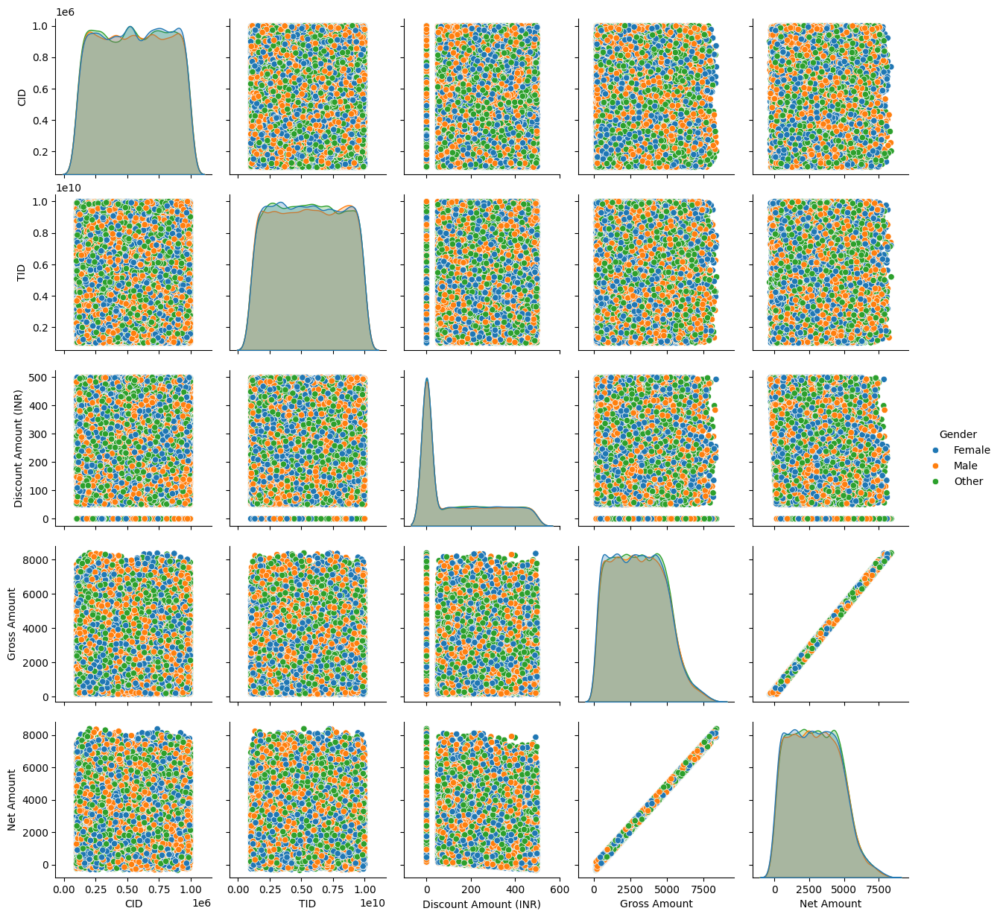

In [17]:
# Visualizing the pairplot
sns.pairplot(df, hue = 'Gender')
plt.show()

#### Understand the Distributioon

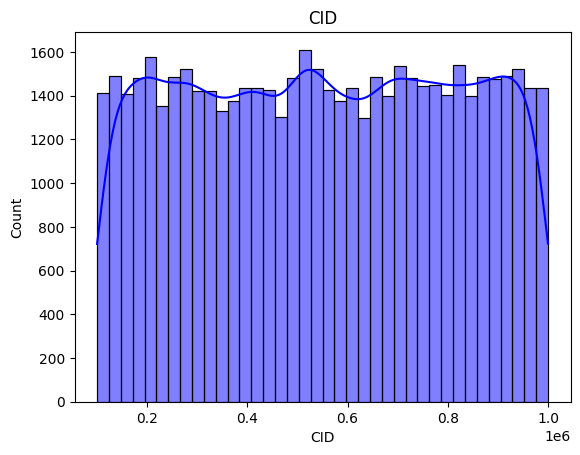

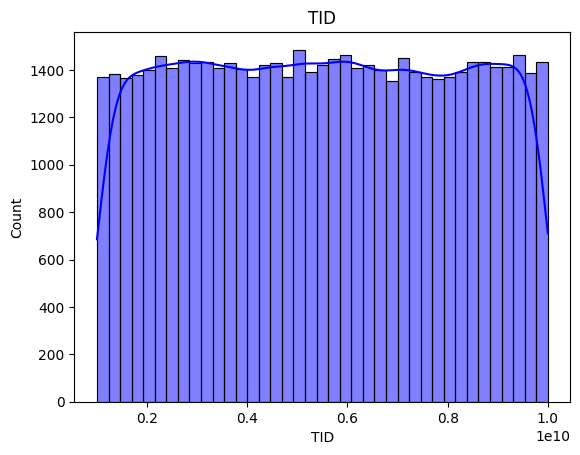

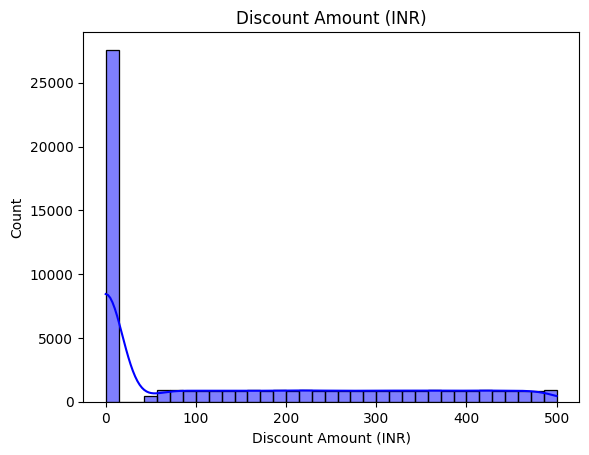

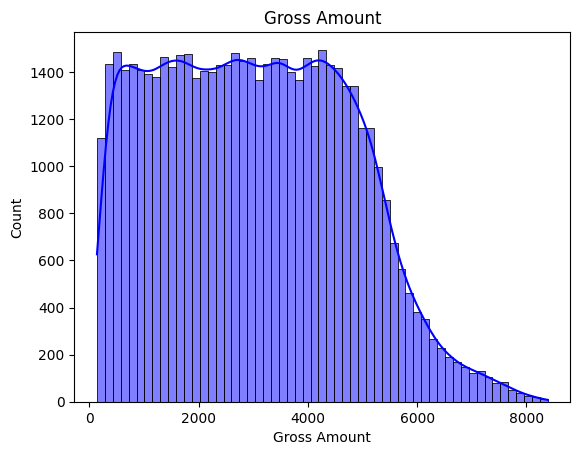

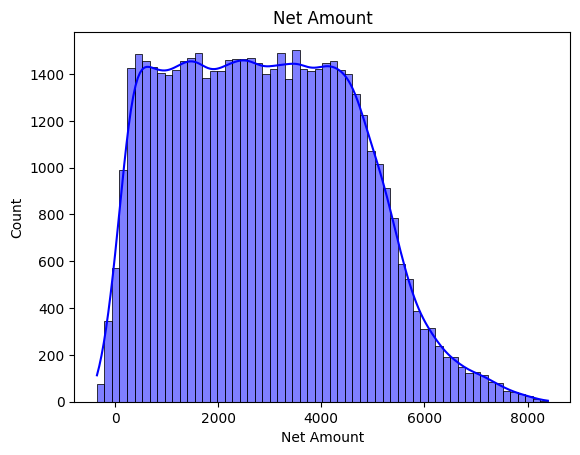

In [19]:
# Histogram to understand the Distribution
for i in df.select_dtypes(include = 'number').columns:
    sns.histplot(data = df, x = i, kde = True, color = 'blue')
    plt.title(f'{i}')
    plt.show()

#### Gender distribution

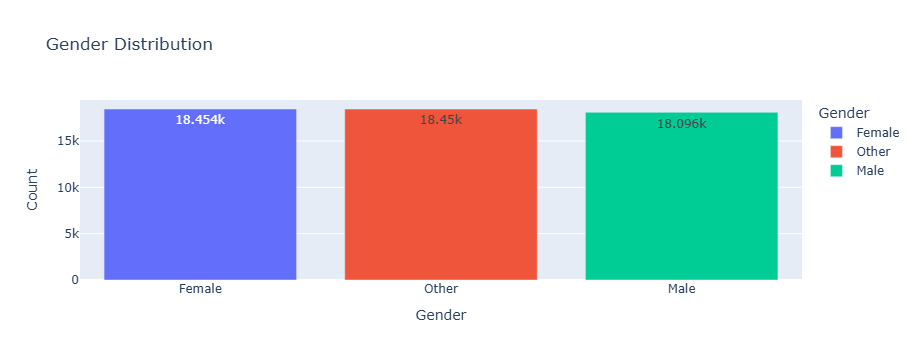

In [21]:
# distributing the Gender with its types
gender_dist = df['Gender'].value_counts().reset_index()
gender_dist.columns = ['Gender','Count']
fig_gender = px.bar(gender_dist, 
                    x = 'Gender', y = 'Count', 
                    title='Gender Distribution',
                    text_auto = True,
                    color = 'Gender')
fig_gender.show()

#### Age Group distribution

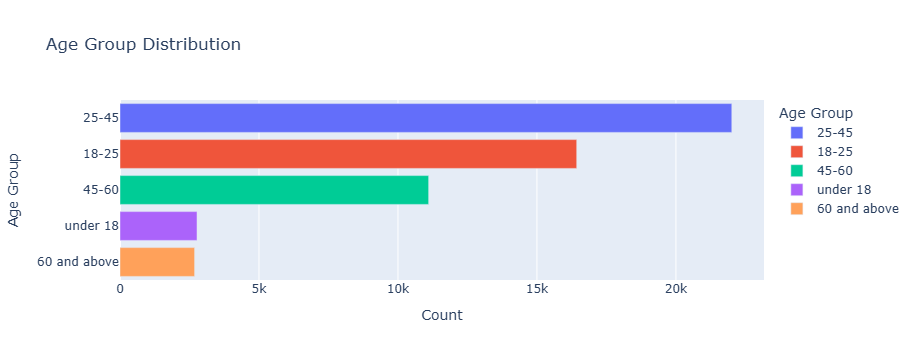

In [23]:
# Distribution of Age group by its types
age_group = df['Age Group'].value_counts().reset_index()
age_group.columns = ['Age Group','Count']
fig = px.bar(age_group, 
                       x = 'Count', y = 'Age Group', 
                       title = 'Age Group Distribution',
                       color = 'Age Group')
fig.show()

#### Product Category

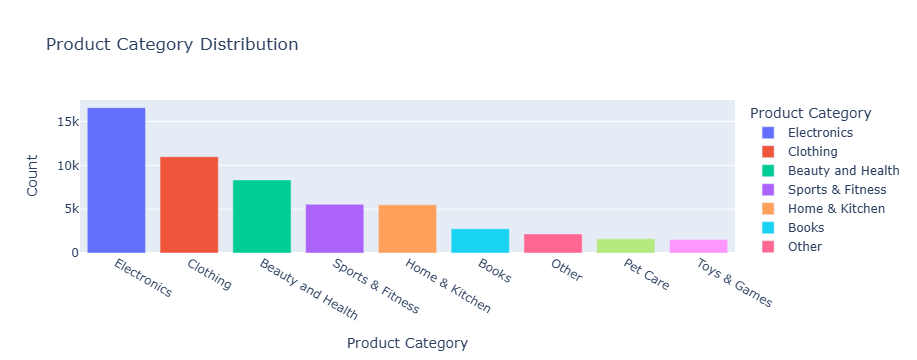

In [25]:
# Bar plot for to represent the types of Product Category
product_category = df['Product Category'].value_counts().reset_index()
product_category.columns = ['Product Category','Count']
fig_category = px.bar(product_category, 
                      x = 'Product Category', y = 'Count',
                      color = 'Product Category',
                      title = 'Product Category Distribution',
                     ) 
fig_category.show()

#### Time series plot for Purchase Date vs Gross Amount

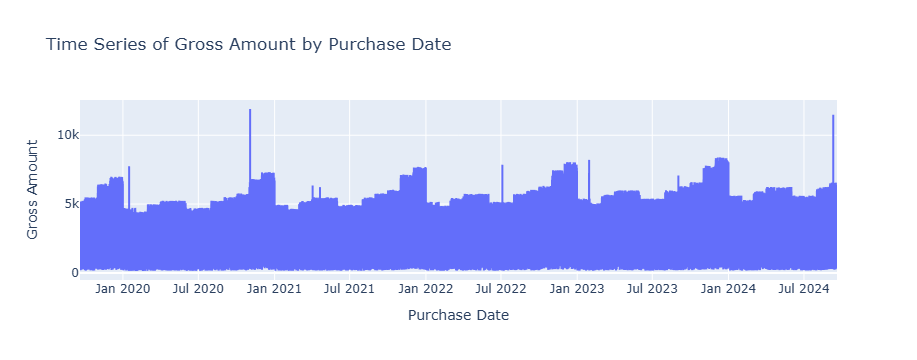

In [27]:
# Line plot for to represent the Purchase Date vs Gross Amount
data_time_series = df.groupby('Purchase Date').agg({'Gross Amount': 'sum'}).reset_index()
fig = px.line(data_time_series, 
              x = 'Purchase Date', 
              y = 'Gross Amount', 
              title='Time Series of Gross Amount by Purchase Date')
fig.show()

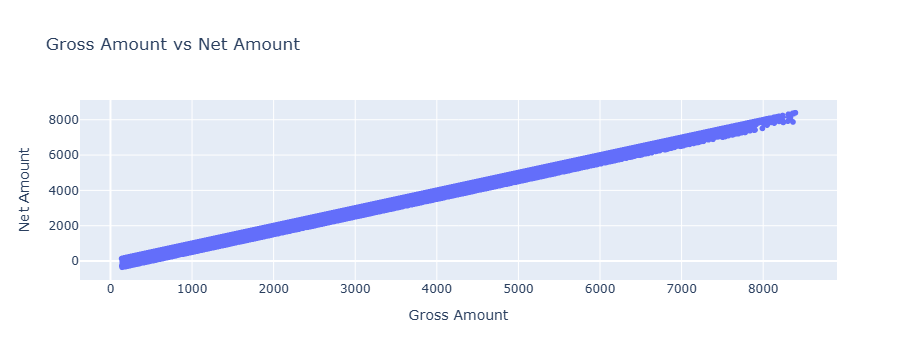

In [28]:
# Scatter plot for Gross Amount vs Net Amount
fig = px.scatter(df, x = 'Gross Amount', y = 'Net Amount', title = 'Gross Amount vs Net Amount', trendline = 'ols')
fig.show()

#### Purchase Method distribution

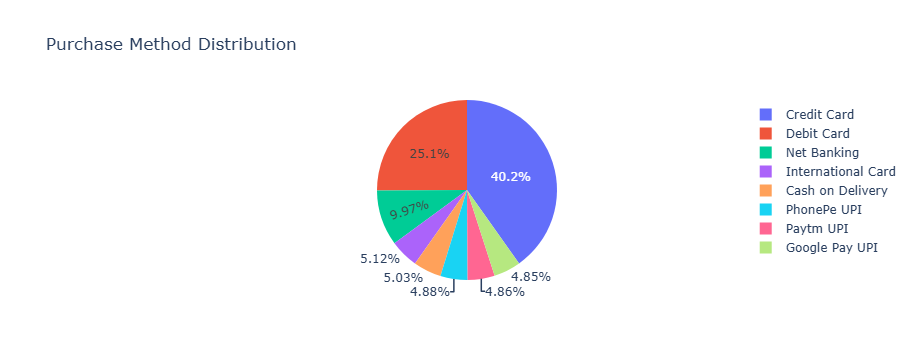

In [30]:
# Pie plot for to represent the Distribution of Purchase Method
fig = px.pie(df, names='Purchase Method', title='Purchase Method Distribution')
fig.show()

### Location-based analysis

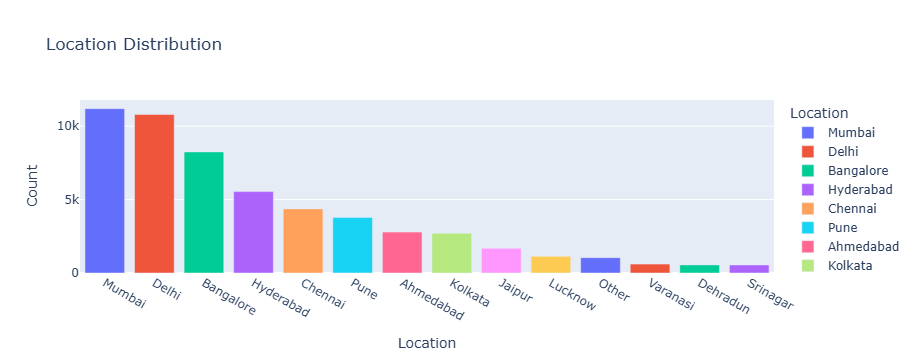

In [32]:
# Value counts of types of Location
# Bar plot for Distribution of Location
location_dist = df['Location'].value_counts().reset_index()
location_dist.columns = ['Location','Count']
fig = px.bar(location_dist, x = 'Location', y = 'Count', color = 'Location', title='Location Distribution')
fig.show()

#### Net Amount across Age Groups

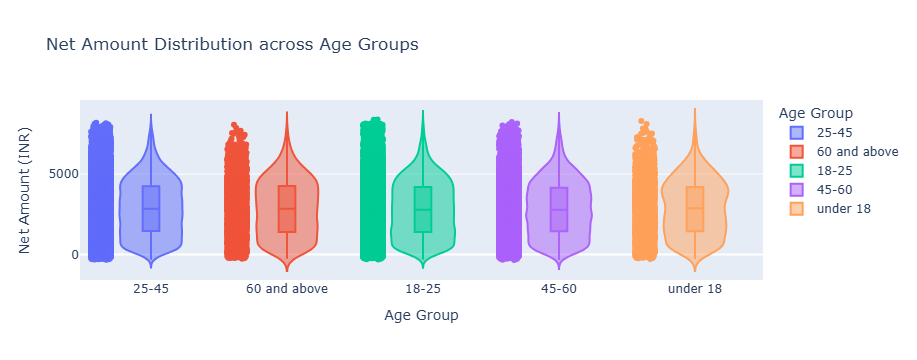

In [34]:
# Violin plot for Distribution of Net Amount across Age Groups
fig = px.violin(df, x = 'Age Group', y = 'Net Amount', title = 'Net Amount Distribution across Age Groups',
                color = 'Age Group', box = True, points = 'all',
                labels = {'Age Group': 'Age Group', 'Net Amount': 'Net Amount (INR)'})
fig.show()

#### Gross Amount across Product Categories

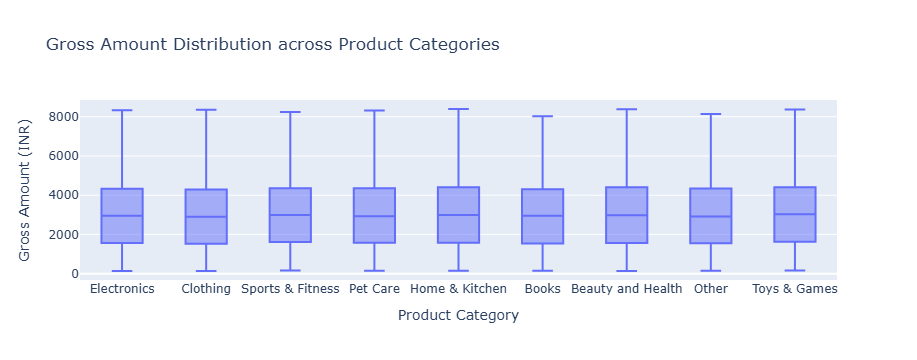

In [36]:
# Box plot for distribution of Gross Amount across Product Categories
fig = px.box(df, x = 'Product Category', y = 'Gross Amount', 
             title = 'Gross Amount Distribution across Product Categories',
             labels={'Product Category': 'Product Category', 'Gross Amount': 'Gross Amount (INR)'})
fig.show()

#### Grouped Bar Plot for Average Net Amount by Gender and Age Group

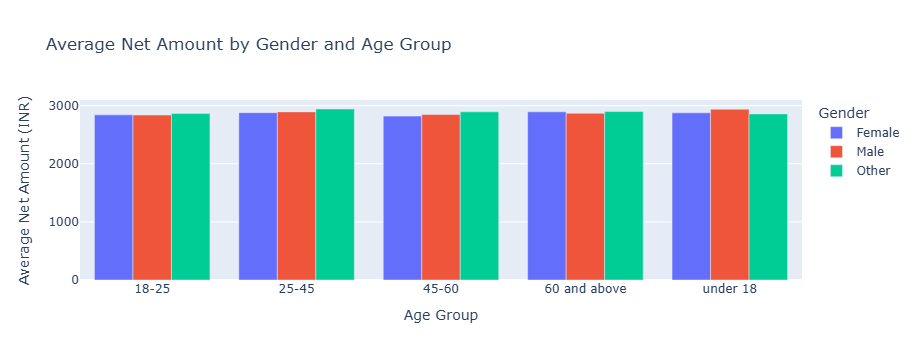

In [38]:
# Grouping Gender and Age Group with respect to Net Amount
# Bar plot for Average Net Amount by Gender and Age Group
avg_net_amount = df.groupby(['Gender', 'Age Group'])['Net Amount'].mean().reset_index()
fig_grouped_bar = px.bar(avg_net_amount, x='Age Group', y='Net Amount', color='Gender', barmode='group', 
                          title='Average Net Amount by Gender and Age Group',
                          labels={'Age Group': 'Age Group', 'Net Amount': 'Average Net Amount (INR)'})
fig_grouped_bar.show()

#### Heatmap for correlation between numerical variables

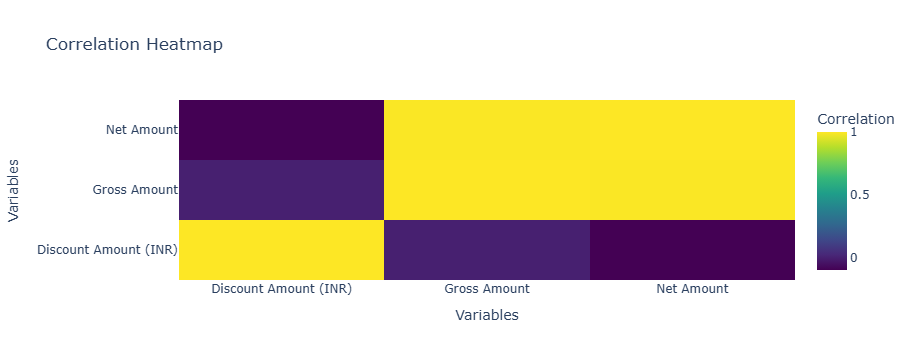

In [40]:
# Correlation matrx of Discount Amount, Gross Amount and Net Amount
# Heatmap to represent the correlation matrix
correlation_matrix = df[['Discount Amount (INR)', 'Gross Amount', 'Net Amount']].corr()
fig_heatmap = go.Figure(data=go.Heatmap(z=correlation_matrix.values, x=correlation_matrix.columns, 
            y=correlation_matrix.columns, colorscale='Viridis', colorbar=dict(title='Correlation')))

fig_heatmap.update_layout(title='Correlation Heatmap', xaxis_title='Variables', yaxis_title='Variables')
fig_heatmap.show()